4. What is the longest match recorded in terms of duration?

Loading Data:

In [12]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns


folder_path = Path('../data/input/raw_match_parquet')

# Time Data
time_dfs = []

for parquet_file in folder_path.glob('time_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file)
        time_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if time_dfs:
    time_data = pd.concat(time_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(time_data.shape)
    print(time_data.head())
    print(f"Successfully combined {len(time_dfs)} away team parquet files.")
else:
    print(f"No 'time_*.parquet' files found in {folder_path} or no files could be read.")

#Away Team Data
all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'country', 'total_prize'])
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} away team parquet files.")
else:
    print(f"No 'away_team_*.parquet' files found in {folder_path} or no files could be read.")

# Home Team Data
all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'country', 'total_prize'])
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")

Successfully read time_11974049.parquet
Successfully read time_11974052.parquet
Successfully read time_11974053.parquet
Successfully read time_11974065.parquet
Successfully read time_11974066.parquet
Successfully read time_11974067.parquet
Successfully read time_11974068.parquet
Successfully read time_11974070.parquet
Successfully read time_11974071.parquet
Successfully read time_11974072.parquet
Successfully read time_11974113.parquet
Successfully read time_11987997.parquet
Successfully read time_11998445.parquet
Successfully read time_11998446.parquet
Successfully read time_11998447.parquet
Successfully read time_11998448.parquet
Successfully read time_11998449.parquet
Successfully read time_11998450.parquet
Successfully read time_11998451.parquet
Successfully read time_11998452.parquet
Successfully read time_11998453.parquet
Successfully read time_11998454.parquet
Successfully read time_11998455.parquet
Successfully read time_11998456.parquet
Successfully read time_11998457.parquet


Calculating Duration and Finding the Longest Match:

In [18]:
period_columns = ['period_1', 'period_2', 'period_3', 'period_4', 'period_5']
for col in period_columns:
    time_data[col] = pd.to_numeric(time_data[col], errors='coerce')

time_data['total_duration'] = time_data[period_columns].sum(axis=1)

longest_match = time_data.loc[time_data['total_duration'].idxmax()]

print(f"The longest match recorded is Match ID: {longest_match['match_id']}")
print(f"Total Duration: {longest_match['total_duration']}")


The longest match recorded is Match ID: 12063611
Total Duration: 336790.0


Visualizing the Data:

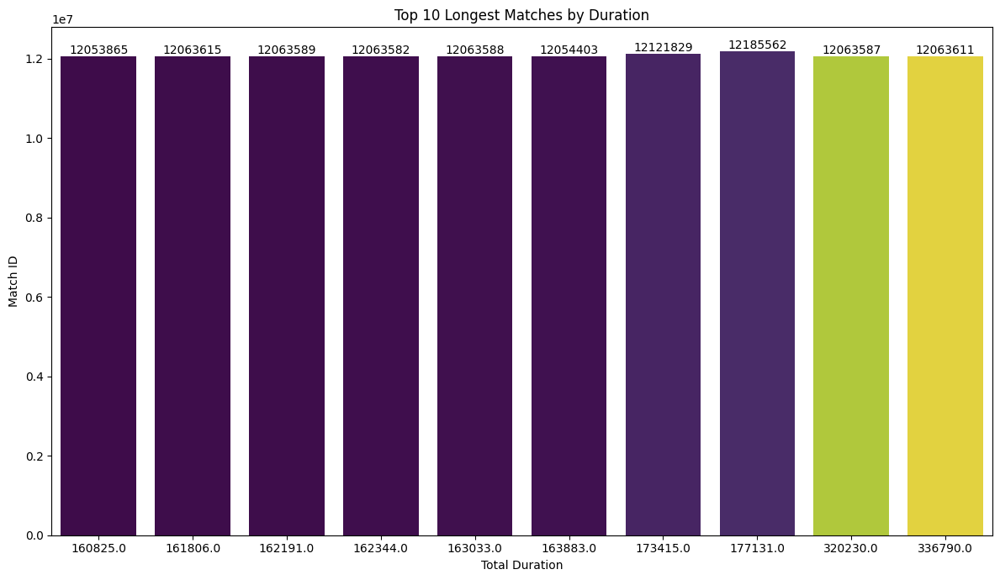

In [33]:
plt.figure(figsize=(12, 7))
ax = sns.barplot(
    x='total_duration',
    y='match_id',
    data=top_10_longest_matches,
    palette='viridis',
    hue='total_duration',
    legend=False
)

for container in ax.containers:
    ax.bar_label(container, fmt='%.0f')

plt.xlabel('Total Duration')
plt.ylabel('Match ID')
plt.title('Top 10 Longest Matches by Duration')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Longerst Matches by Duration.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

Finding the Country with the Most Prize and the Least Match time:

In [25]:
if time_data.empty or away_team_data.empty or home_team_data.empty:
    print("\nError: One or more DataFrames are empty. Cannot proceed with analysis.")
else:
    period_cols = ['period_1', 'period_2', 'period_3', 'period_4', 'period_5']
    for col in period_cols:
        time_data[col] = pd.to_numeric(time_data[col], errors='coerce')
    time_data['total_duration'] = time_data[period_cols].sum(axis=1)

    merged_df = pd.merge(time_data, home_team_data, on='match_id', how='left', suffixes=('_time', '_home'))
    merged_df = pd.merge(merged_df, away_team_data, on='match_id', how='left', suffixes=('_home', '_away'))

    home_df = merged_df[['match_id', 'total_duration', 'total_prize_home', 'country_home']].copy()
    away_df = merged_df[['match_id', 'total_duration', 'total_prize_away', 'country_away']].copy()
    
    home_df.rename(columns={'total_prize_home': 'total_prize', 'country_home': 'country'}, inplace=True)
    away_df.rename(columns={'total_prize_away': 'total_prize', 'country_away': 'country'}, inplace=True)
    
    all_teams_df = pd.concat([home_df, away_df], ignore_index=True)

    all_teams_df['country'] = all_teams_df['country'].fillna('Not Mentioned')
    all_teams_df['total_prize'] = pd.to_numeric(all_teams_df['total_prize'], errors='coerce').fillna(0)
    
    country_summary = all_teams_df.groupby('country').agg(
        total_prize=('total_prize', 'sum'),
        total_duration=('total_duration', 'sum')
    ).reset_index()

    most_prize_country = country_summary.loc[country_summary['total_prize'].idxmax()]

    least_time_country = country_summary.loc[country_summary['total_duration'].idxmin()]


Visualizing the Data:

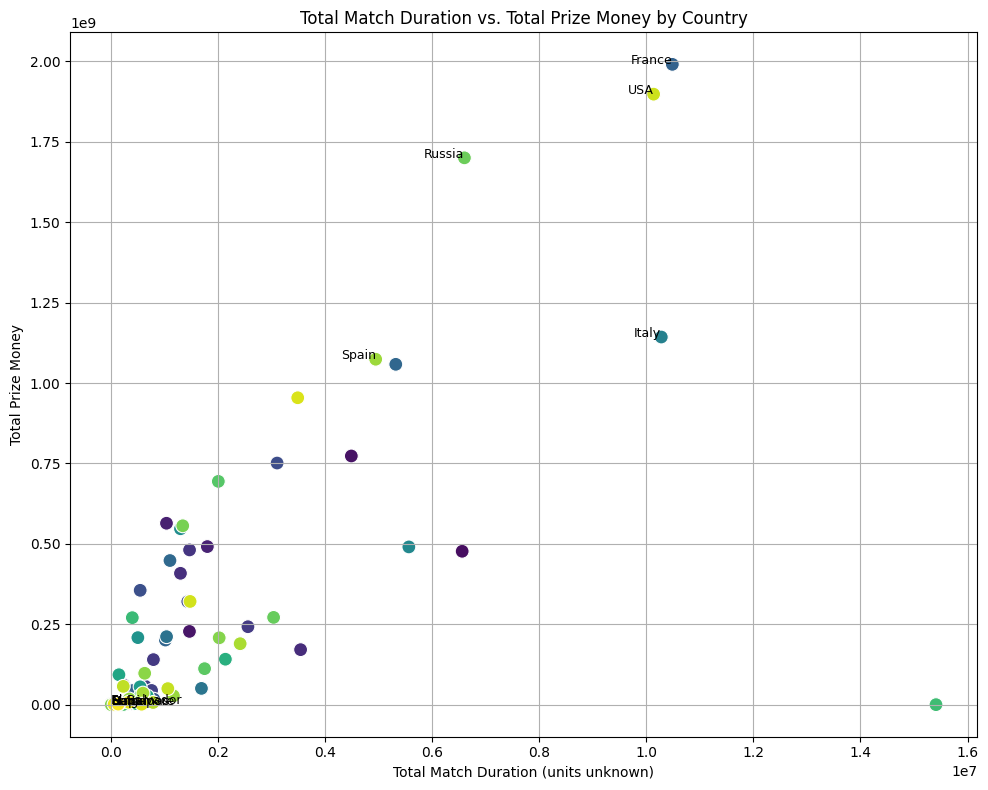

In [34]:

plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=country_summary,
    x='total_duration',
    y='total_prize',
    hue='country',
    s=100,
    palette='viridis',
    legend=False 
    )


for i, row in country_summary.nlargest(5, 'total_prize').iterrows():
    plt.text(row['total_duration'], row['total_prize'], row['country'], fontsize=9, ha='right')
for i, row in country_summary.nsmallest(5, 'total_duration').iterrows():
    plt.text(row['total_duration'], row['total_prize'], row['country'], fontsize=9, ha='left')

plt.title('Total Match Duration vs. Total Prize Money by Country')
plt.xlabel('Total Match Duration (units unknown)')
plt.ylabel('Total Prize Money')
plt.grid(True)
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Total Match Duration vs. Total Prize Money by Country.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)


plt.show()